# Heuristics -> Metrics
1. Course Code
  1. Department code
    1. Clustering based on crosslistings
    2. More generally, if the dept changes AND there is no crosslisting with the old dept, there is a red flag
  2. Course number
    1. 1st int - ~~The first int in course number means a lot if there is a significant change~~ There are many cases where a 1- or 200 level class is crosslisted as a graduate level class. Only really means anything if you go from 100 -> 400 etc
    2. 2nd - 4th int - course numbering is somewhat arbitrary therefore does sometimes change
2. Title
  1. ~~Changes infrequently? -> direct comparison based on string distance would work~~ -> Want some semantic similarity because string distance approach would assume "Prog. Langauges I" and "Prog. Languages II" are the same
    1. Could try to take into account semantic similary based on something like [sematch](http://gsi-upm.github.io/sematch/)
3. Prerequisites
  1. Do a recursive call to test the difference between the courses in the pre-requisites

## Special Cases
* Course diverges into 2 different courses
* "Cross-listings" with different titles
* Cross listings with different codes but the same title

# Questions to answer
1. How often does title change?
2. How often does description change?
3. What are the scale of these kinds of changes?
4. How often do prerequisites change?
5. Are there any correlations between when these changes occur?
6. How often does the most naive approach work?

In [3]:
import os, sys
sys.path.insert(0, os.getcwd())
os.environ.setdefault("DJANGO_SETTINGS_MODULE", "PennCourses.settings.development")
import django

In [4]:
django.setup()

In [5]:
import numpy as np
import pandas as pd
import csv
import jellyfish

In [4]:
lines = []
with open("course_data.csv") as f:
    data_reader = csv.reader(f)
    with open('course_data_courses_only.csv', 'w', newline='') as fout:
        data_writer = csv.writer(fout, delimiter=',', quoting=csv.QUOTE_MINIMAL)
        for i, row in enumerate(data_reader):
            if (row[0] == "courses"):
                data_writer.writerow(row)
                lines.append(i)

In [6]:
df = pd.read_csv('course_data_courses_only.csv', verbose=True, names= [
        "type",
        "id",
        "semester",
        "department_id",
        "code",
        "title",
        "description",
        "full_code",
        "prerequisites",
        "primary_listing_id",
]).sort_values(by="semester")

Tokenization took: 168.03 ms
Type conversion took: 176.00 ms
Parser memory cleanup took: 0.00 ms
Tokenization took: 112.01 ms
Type conversion took: 104.03 ms
Parser memory cleanup took: 0.00 ms


In [7]:
grouped_by_full_code = df.groupby(by="full_code")
grouped_by_full_code.get_group("CIS-120")

,type,id,semester,department_id,code,title,description,full_code,prerequisites,primary_listing_id
85117,courses,58939,2007C,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,58939
24479,courses,59058,2008A,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59058
83347,courses,59025,2008C,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59025
78708,courses,58972,2009A,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,58972
49046,courses,59000,2009C,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59000
116333,courses,59186,2010A,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59186
21512,courses,59115,2010C,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59115
17254,courses,59085,2011A,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59085
81548,courses,59147,2011C,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59147
119366,courses,59216,2012A,1,120,Prog Lang & Tech I,NaN,CIS-120,NaN,59216


In [8]:
grouped_by_dept_id = df.groupby(by="department_id")
grouped_by_dept_id.get_group(1)

,type,id,semester,department_id,code,title,description,full_code,prerequisites,primary_listing_id
80419,courses,95724,1994A,1,540,Operating Systems,NaN,CIS-540,NaN,95724
80349,courses,93976,1994A,1,502,Analysis Of Algorithms,NaN,CIS-502,NaN,93976
79654,courses,106911,1994A,1,510,Computer-Aided Design,NaN,CIS-510,NaN,106911
79734,courses,97653,1994A,1,511,Theory Of Computation,NaN,CIS-511,NaN,97653
90466,courses,86855,1994C,1,560,Computer Graphics,NaN,CIS-560,NaN,86855
...,...,...,...,...,...,...,...,...,...,...
12631,courses,115514,2022A,1,990,NaN,NaN,CIS-990,NaN,None
12639,courses,119450,2022A,1,511,NaN,NaN,CIS-511,NaN,None
12613,courses,119969,2022A,1,502,Analysis of Algorithms,An investigation of paradigms for design and a...,CIS-502,NaN,119969
12614,courses,116521,2022A,1,520,Machine Learning,This course covers the foundations of statisti...,CIS-520,NaN,116521


In [9]:
pd.Series(df['semester'].unique()).sort_values()

0     1994A
1     1994C
2     1995A
3     1995C
4     1996A
      ...  
69    2020C
70    2021A
71    2021B
72    2021C
73    2022A
Length: 74, dtype: object

In [10]:
title_changes = {}
for full_code, group in grouped_by_full_code:
    title_changes[full_code] = (group['title'].shift() != group['title']).sum() - 1 # Subtract 1 because of shift erroir

In [11]:
high_title_changes = dict(sorted(filter(lambda x: x[1] >= 2, title_changes.items()), key=lambda x: x[1], reverse=True))

In [12]:
high_title_changes

{'NURS-637': 65,
 'PSCI-598': 55,
 'HIST-204': 54,
 'ENGL-292': 53,
 'HIST-202': 53,
 'ENGL-103': 47,
 'HIST-206': 47,
 'PSCI-498': 47,
 'PSCI-398': 46,
 'THAR-275': 46,
 'ENGL-016': 45,
 'ENGL-290': 45,
 'HIST-201': 45,
 'ARTH-301': 44,
 'ANTH-001': 43,
 'PHYS-101': 43,
 'SOCI-230': 43,
 'ENGL-135': 42,
 'SOCI-041': 42,
 'ARTH-100': 41,
 'LATN-309': 41,
 'INTR-290': 40,
 'PSCI-150': 40,
 'SPAN-386': 40,
 'COML-282': 39,
 'PSCI-198': 39,
 'PSCI-330': 39,
 'GREK-309': 38,
 'SPAN-396': 38,
 'ECON-002': 37,
 'ENGL-101': 37,
 'HIST-203': 37,
 'HIST-214': 37,
 'ANTH-003': 36,
 'ENGL-261': 36,
 'ANTH-002': 35,
 'ENGL-090': 35,
 'ITAL-300': 35,
 'ECON-001': 34,
 'FNAR-635': 34,
 'PSCI-130': 34,
 'PSCI-298': 34,
 'SPAN-390': 34,
 'ENGL-255': 33,
 'PPE-475': 33,
 'WRIT-030': 32,
 'ACCT-101': 31,
 'NURS-370': 31,
 'ENGL-102': 30,
 'ENGL-281': 30,
 'ENGL-010': 29,
 'ENGL-291': 29,
 'SPAN-380': 29,
 'SPAN-394': 29,
 'ENGL-293': 28,
 'HIST-212': 28,
 'LALS-396': 27,
 'LALS-397': 27,
 'MUSC-016': 27

# Test Dataset
* Sampling of course pairings that are both valid and invalid (couple hundred of each)
* Valid: get y.o.y course pairings with high similarity
  * Get some entire course lineages, too
* Invalid 
  * Randomly select courses from same dept
  * Some courses that are completely different
## Groupings to get
1. Same dept/semester different course code (would have to verify courses are actually different)
2. Same dept, diff semester, diff course code
3. Same dept, diff semester, same course code
4. (Special case) same course code, different content -> this should always be manually handled!
5. (Special case) 

## Method
1. Group courses into departments, semesters, years
2. Within each dept, select 2 random course code at a time and store them in an aggregated set and then pairwise
3. For each course in the set, get a function to get its entire history in order with yoy pairs
  1. Also randomly grab rows from the course's history
  
##

## Prerequisite similarity metrics
* If all prereqs change then probably a dept wide change
* Best served by going through the prereqs first
  * If the 2 prereqs match based on this algorithm, then base it off of that --> recursive call
* Take average prerequisite similarity?
  * What if very few prereqs match? -> probably an issue
  * Generally want one of them to be a subset of the other 
  * Maybe include an adjustment factor based on how many prereqs they have (since if there are no prereqs for 1 then similarity might be skewed)
 

## Course Title and Description Similarity Metrics
* Use direct character similarity
* Use semantic similarity metrics (ie like described [here](https://towardsdatascience.com/semantic-similarity-using-transformers-8f3cb5bf66d6) using pytorch with sentence transformers)

# Testing Lev Distance
## Title-length normalized lev distance between adj years of same course
* The two plots below represent (1) the avg. title-length normalized Lev distance between subsequent years of the same course and (2) the same plot but with the 0-.1 bin removed

In [12]:
def lev_divided_by_avg_title_length(title1, title2):
    if title1 is np.NaN or title2 is np.NaN:
        return 0.0
    return 2 * jellyfish.levenshtein_distance(title1, title2) / (len(title1) + len(title2))

In [13]:
def apply_to_shifted(func, x, shift = 1):
    """
    Shifts `x` by `shift`, then feeds both `x` and shifted `x` into function (via map), discarding the `shift` values
    at the start of `x` and end of shifted `x`. Returns `map` object.
    """
    return map(func, x[shift:], x[:-shift])

In [14]:
def hist_title_by_course(df):
    hist, bins = np.histogram([], range=(0.0, 1.0))
    for full_code, group in grouped_by_full_code:
        title_sorted_by_sem = group.sort_values(by = "semester")['title']
        out = apply_to_shifted(lev_divided_by_avg_title_length, title_sorted_by_sem)
        hist += np.histogram(np.array(list(out)), bins=bins, range=(0.0, 1.0))[0]
    return hist

<AxesSubplot:>

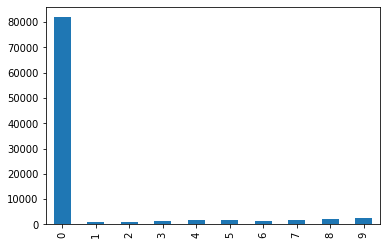

In [15]:
pd.Series(hist_title_by_course(df)).plot.bar()

<AxesSubplot:>

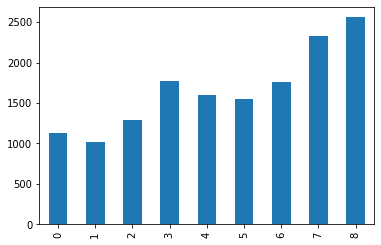

In [16]:
pd.Series(hist_title_by_course(df)[1:]).plot.bar()

## Avg Title Length Normalizd Lev Distance Across Courses within Same Semester

In [17]:
def hist_column_by_groupby(df, groupby, column, f, randomize=True):
    hist, bins = np.histogram([], range=(0.0, 1.0))
    for sem, group in df.groupby(groupby):
        column_in_groupby = group.sample(frac=1)[column] if randomize else group[column]
        out = list(apply_to_shifted(f, column_in_groupby))
        print([i for i in range(len(out)) if out[i] is None])
        hist += np.histogram(np.array(list(out)), bins=bins, range=(0.0, 1.0))[0]
    return hist, column_in_groupby

def lev_title_hist_title_by_sem(df):
    return hist_column_by_groupby(df, groupby='semester', column='title', f=lev_divided_by_avg_title_length)

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


<AxesSubplot:>

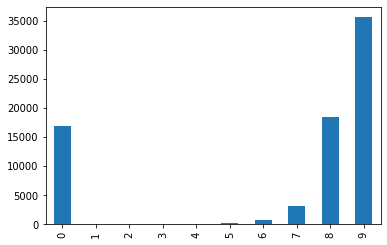

In [18]:
pd.Series(lev_title_hist_title_by_sem(df)[0]).plot.bar()

# Drop Crosslistings

In [19]:
primary_listings_only_bool_index = pd.to_numeric(df['primary_listing_id'], errors="coerce") == df['id']

In [20]:
hist_primary_listings_only_same_sem = lev_title_hist_title_by_sem(df[primary_listings_only_bool_index])[0]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


<AxesSubplot:>

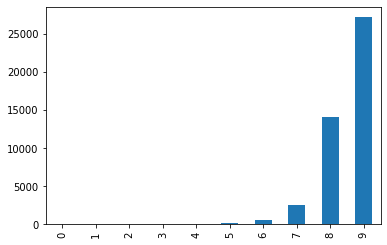

In [21]:
pd.Series(hist_primary_listings_only_same_sem).plot.bar()

<AxesSubplot:>

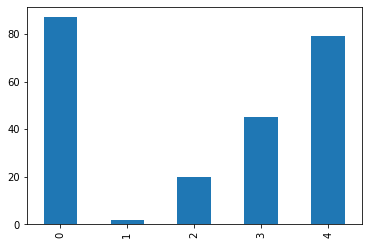

In [22]:
pd.Series(hist_primary_listings_only_same_sem[:5]).plot.bar()

## Check False Positives
* The previous analysis shows that the number of false positives is small
* Need to check for false negatives
* Try to do some manual checking for courses on the edge
### Manual Checks
* Randomly sample from those courses around bins 5-7 of the histogram

# Vectorization using TFIDF

In [23]:
import ipywidgets as widgets
from IPython.display import display
output = widgets.Output()

grouped_by_sem = df.groupby('semester')
for i, (sem, group) in enumerate(grouped_by_sem):
    title_randomized = group.sample(frac=1)['title']
    lev_scores = list(apply_to_shifted(lev_divided_by_avg_title_length, title_randomized))
    disp_df = pd.DataFrame(
        {
         'title_randomized' : title_randomized[1:].values,
         'title_randomized_shifted' : title_randomized.shift()[:-1].values,
         'lev_scores' : lev_scores
        }
    )
    # disp_df[(disp_df['lev_scores'] > .5) & (disp_df['lev_scores'] < .7)].to_csv(f'{sem}')

In [24]:
from plan.management.commands.trainrecommender import get_descriptions, vectorize_courses_by_description
valid_desc_rows = df[df['description'].notna()]
valid_desc_rows = valid_desc_rows.reset_index() # reindex so that this numpy array does not use the original index, which may be out of order

In [25]:
valid_desc_rows['description']

0        See the English Department's website at www.en...
1        Please see department website for a current co...
2                           Topics vary from year to year.
3        "Theory" can be exciting and seductive to some...
4        "Theory" can be exciting and seductive to some...
                               ...                        
19017    According to research sponsored by the Organiz...
19018    Students will be placed in a variety of clinic...
19019    This graduate seminar examines the dynamic rel...
19020                                     Lab for Math 240
19021    This seminar will explore the history of build...
Name: description, Length: 19022, dtype: object

In [26]:
description_vectors = vectorize_courses_by_description(valid_desc_rows['description'].to_numpy())

In [27]:
from sklearn.metrics.pairwise import cosine_similarity

In [28]:
cis_120_2022A = valid_desc_rows.index[(valid_desc_rows['full_code'] == 'CIS-120') & (valid_desc_rows['semester'] == "2022A")]
cis_120_2021A = valid_desc_rows.index[(valid_desc_rows['full_code'] == 'CIS-120') & (valid_desc_rows['semester'] == "2021A")]
cis_121_2022A = valid_desc_rows.index[(valid_desc_rows['full_code'] == 'CIS-121') & (valid_desc_rows['semester'] == "2022A")]

In [29]:
# Test 2 related, but not identical courses
print(valid_desc_rows['description'][cis_120_2022A])
print(valid_desc_rows['description'][cis_121_2022A])
cosine_similarity(description_vectors[cis_120_2022A], description_vectors[cis_121_2022A])

16436    A fast-paced introduction to the fundamental c...
Name: description, dtype: object
16885    This is a course about Algorithms and Data Str...
Name: description, dtype: object


array([[0.17597908]])

In [30]:
# Test 2 identical courses across 2 different semesters
print(valid_desc_rows['description'][cis_120_2022A])
print(valid_desc_rows['description'][cis_120_2021A])
print(description_vectors[cis_120_2022A].shape)
cosine_similarity(description_vectors[cis_120_2022A], description_vectors[cis_120_2021A])

16436    A fast-paced introduction to the fundamental c...
Name: description, dtype: object
12582    A fast-paced introduction to the fundamental c...
Name: description, dtype: object
(1, 500)


array([[1.]])

In [31]:
desc_to_vectors = dict(zip(valid_desc_rows['description'], description_vectors))
def cos_sim_given_desc(desc1, desc2):
    if desc1 is np.NaN or desc2 is np.NaN:
        return 0.0
    cosine_similarity(desc_to_vectors[desc1].reshape(1, -1), desc_to_vectors[desc2].reshape(1, -1))

In [32]:
cosine_similarity(np.array([1, 3]).reshape(1, -1), np.array([1, 2]).reshape(1, -1))

array([[0.98994949]])

<AxesSubplot:>

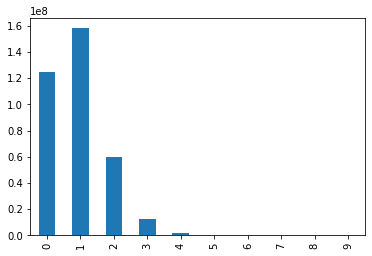

In [33]:
hist,bins = np.histogram(cosine_similarity(description_vectors).flatten(), range=[0.,1.])
pd.Series(hist).plot.bar()

<AxesSubplot:>

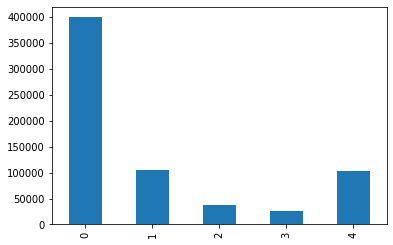

In [34]:
pd.Series(hist[5:]).plot.bar()

In [35]:
pairwise_similarities = cosine_similarity(description_vectors) # A matrix representing pairwise similarities
print(pairwise_similarities.shape)
thresh_inds = np.argwhere(np.logical_and(pairwise_similarities < .95, pairwise_similarities > .8)) # Arbitrarily choose .8 as thresh and get all indices where pairwise_similarities is greater
thresh_inds = thresh_inds[thresh_inds[:, 0] < thresh_inds[:,1]] # Remove all indices corresponding the upper triangle and diagonal (ie only take lower triangle)

(19022, 19022)


In [37]:
# print high (but not perfect) similarity descriptions
exclude_strings = ["department website for a current course description",
                   "complete description of the current offerings",
                   "department website for current description",
                   "topics vary", ]# Exclude if contains one of these substrings in any case
desc_series = valid_desc_rows['description']
for desc1_ind, desc2_ind in thresh_inds:
    desc1, desc2 = desc_series.loc[desc1_ind].lower(), desc_series.loc[desc2_ind].lower()
    skip = desc1 == desc2 # Skip if they are identical
    for substr in exclude_strings:
        if substr in desc1 or substr in desc2:
            skip = True
            break
    if skip:
        continue
    print(desc1)
    print("--")
    print(desc2)
    print("============")

every human culture that has ever been described makes some form of music. the musics of different cultures cover a wide range of styles, but also display fascinating similarities, and a number of features are shared by even the most disparate musical traditions. within our own culture, music is inescapable-there are very few individuals who do not listen to some form of music every day and far more who listen to music virtually all day long. appreciation of music comes very early: newborns prefer music to normal speech and mothers all over the world sing to their babies in a fundamentally similar way. and yet, despite this seeming ubiquity, the real origin and purpose of music remains unknown. music is obviously related to language, but how? why do so many cultures make music in such fundamentally similar ways? what goes into the formation of music "taste" and preferences? does music have survival value, or is it merely "auditory cheesecake", a superfluous byproduct of evolution as so

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



--
topics vary. please check the french department's website for the course description. https://www.sas.upenn.edu/french/pc
please check the department's website for the course description. https://www.sas.upenn.edu/french/pc
--
please see the department's website for the course description: https://www.sas.upenn.edu/french/pc
this course covers fixed income securities (including fixed income derivatives) and provides an introduction to the markets in which they are traded, as well as to the tools that are used to value these securities and to assess and manage their risk. quantitative models play a key role in the valuation and risk management of these securities. in addition to course prerequisites, fnce 613 is recommended but not required.
--
(formerly fnce 235) this course covers fixed income securities (including fixed income derivatives) and provides an introduction to the markets in which they are traded, as well as to the tools that are used to value these securities and to as

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




this writing seminar focuses on a scholarly inquiry in the field of sociology, the study of the development, structure, and function of human society. this seminar will introduce students to scholarly conversations on a specific topic in this discipline as a basis for understanding discipline- and profession-based writing. this includes types of reasoning, evidence, citations practices, and other means of creating, testing, and sharing knowledge with diverse audiences. throughout, students are introduced to new writing situations as a means of sharpening their skills and learning how to be adaptive, effective writers.
this writing seminar focuses on a scholarly inquiry in the field of health and societies, which uses the tools of the humanities and the social sciences to study science, technology, medicine, and the environment. this seminar will introduce students to scholarly conversations on a specific topic in this discipline as a basis for understanding discipline- and profession-

KeyboardInterrupt: 

see the english department's website at www.english.upenn.edu for a complete description of the current offerings.
--
an advanced seminar in anglophone african literature, possibly including a few works in translation. see the english department's website at www.english.upenn.edu for a complete description of the current offerings.
see the english department's website at www.english.upenn.edu for a complete description of the current offerings.
--
this course treats some aspect of literary and cultural politics in the 20th-century with emphasis varying by instructor. see the english department's website at www.english.upenn.edu for a complete description of the current offerings.
see the english department's website at www.english.upenn.edu for a complete description of the current offerings.
--
a seminar treating any one of the major american writers. past versions have focused on melville, whitman, twain, james, pound, eliot, and others. see the english department's website at www.en

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



this writing seminar focuses on a scholarly inquiry in the field of history. this seminar will introduce students to scholarly conversations on a specific topic in this discipline as a basis for understanding discipline- and profession-based writing. this includes types of reasoning, evidence, citation practices, and other means of creating, testing, and sharing knowledge with diverse audiences. throughout, students are introduced to new writing situations as a means of sharpening their skills and learning how to be adaptive, effective writers.
--
this writing seminar focuses on a scholarly inquiry in the study of the biological basis of behavior, an interdisciplinary major that explores biological, psychological, computational, and clinical approaches to understand the nervous system as the biological basis of behavior, as well as perception, memory, motivation, and emotion. this seminar will introduce students to scholarly conversations on a specific topic in this discipline as a bas

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



--
topics vary. please see the spanish department's website for the current course description: https://www.sas.upenn.edu/hispanic-portuguese-studies/pc
topics vary. for current course description, please see department's webpage: https://www.sas.upenn.edu/hispanic-portuguese-studies/pc
--
topics will vary. please see department's website for current course description: https://www.sas.upenn.edu/french/pc
topics vary. for current course description, please see department's webpage: https://www.sas.upenn.edu/hispanic-portuguese-studies/pc
--
topics vary. please see the spanish department's website for the current course description: https://www.sas.upenn.edu/hispanic-portuguese-studies/pc
topics vary. for current course description, please see department's webpage: https://www.sas.upenn.edu/hispanic-portuguese-studies/pc
--
topics vary. please see the spanish department's website for the current course description: https://www.sas.upenn.edu/hispanic-portuguese-studies/pc
topics vary. fo

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




--
this writing seminar focuses on a scholarly inquiry in the field of asian and middle eastern studies, an interdisciplinary examination of the history, experiences, cultures, and policies relevant to asian americans. it will introduce students to scholarly conversations on a specific topic in this discipline as a basis for understanding discipline- and profession-based writing. this includes types of reasoning, evidence, citation practices, and other means of creating, testing, and sharing knowledge with diverse audiences. throughout, students are introduced to new writing situations as a means of sharpening their skills and learning how to be adaptive, effective writers.
this writing seminar focuses on a scholarly inquiry in the field of environmental studies. this seminar will introduce students to scholarly conversations on a specific topic in this discipline as a basis for understanding discipline- and profession-based writing. this includes types of reasoning, evidence, citatio

In [ ]:
valid_desc_rows.head()